<a href="https://colab.research.google.com/github/fahriyegrl/Gemini_AI_rename_images/blob/main/Gemini_AI_rename_images_after_reviewing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install -q google-generativeai

In [ ]:
pip show google-generativeai

Name: google-generativeai
Version: 0.7.2
Summary: Google Generative AI High level API client library and tools.
Home-page: https://github.com/google/generative-ai-python
Author: Google LLC
Author-email: googleapis-packages@google.com
License: Apache 2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: google-ai-generativelanguage, google-api-core, google-api-python-client, google-auth, protobuf, pydantic, tqdm, typing-extensions
Required-by: 


In [ ]:
from google.colab import userdata
import google.generativeai as genai

GOOGLE_API_KEY = userdata.get('GOOGLE_API_KEY')

genai.configure(api_key=GOOGLE_API_KEY)

In [ ]:
from IPython.display import display

import os
from pathlib import Path
from PIL import Image

def get_image_paths(folder_path):

  extension = ('.jpg', '.jpeg', '.png')

  for dirpath, dirnamess, filenames in os.walk(folder_path):
    # print(dirpath)
    # print(dirnamess)
    # print(filenames)

    for file in filenames:
      path = os.path.join(dirpath, file)
      # print(path)
      img = Image.open(path)
      display(img)
      yield img, path


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# from google.colab import files
# uploaded = files.upload()


In [ ]:
folder_path = "/content/drive/MyDrive/images"
print(os.listdir(folder_path))

['IMG_1804.jpg', 'IMG_2692.jpg', 'IMG_1927.jpg']


In [ ]:
# from IPython.display import display

# for dirpath, dirnamess, filenames in os.walk(folder_path):
#   print(dirpath)
#   print(dirnamess)
#   print(filenames)
#   for file in filenames:
#     path = os.path.join(dirpath, file)
#     print(path)
#     img = Image.open(path)
#     display(img)

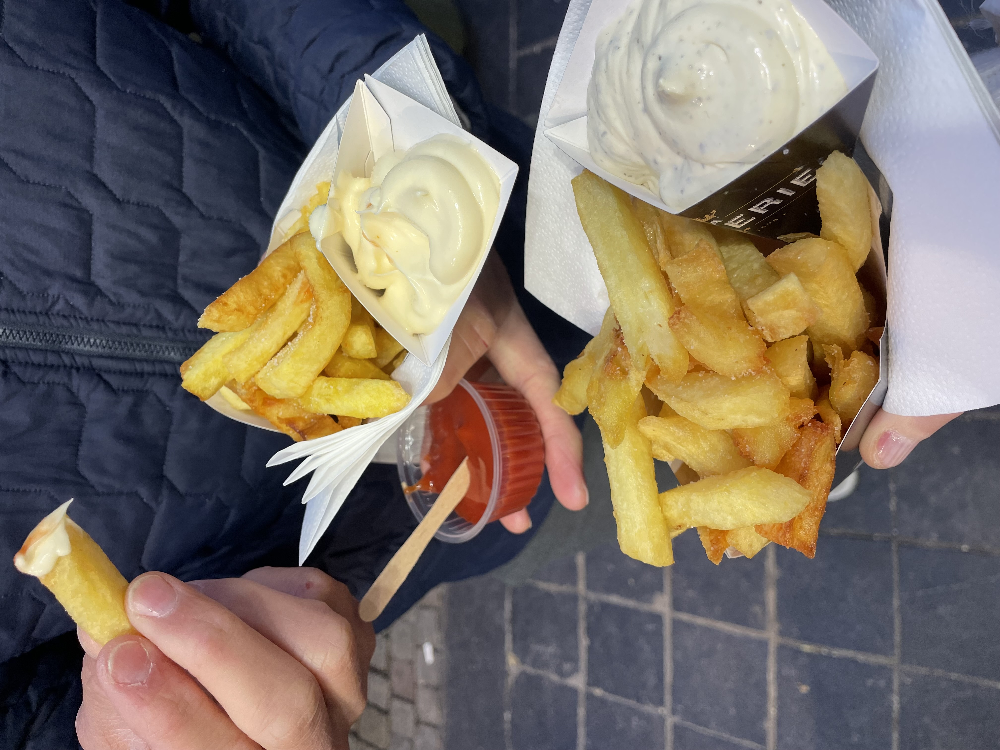

<PIL.MpoImagePlugin.MpoImageFile image mode=RGB size=4032x3024 at 0x7AF87CF03790> /content/drive/MyDrive/images/IMG_1804.jpg


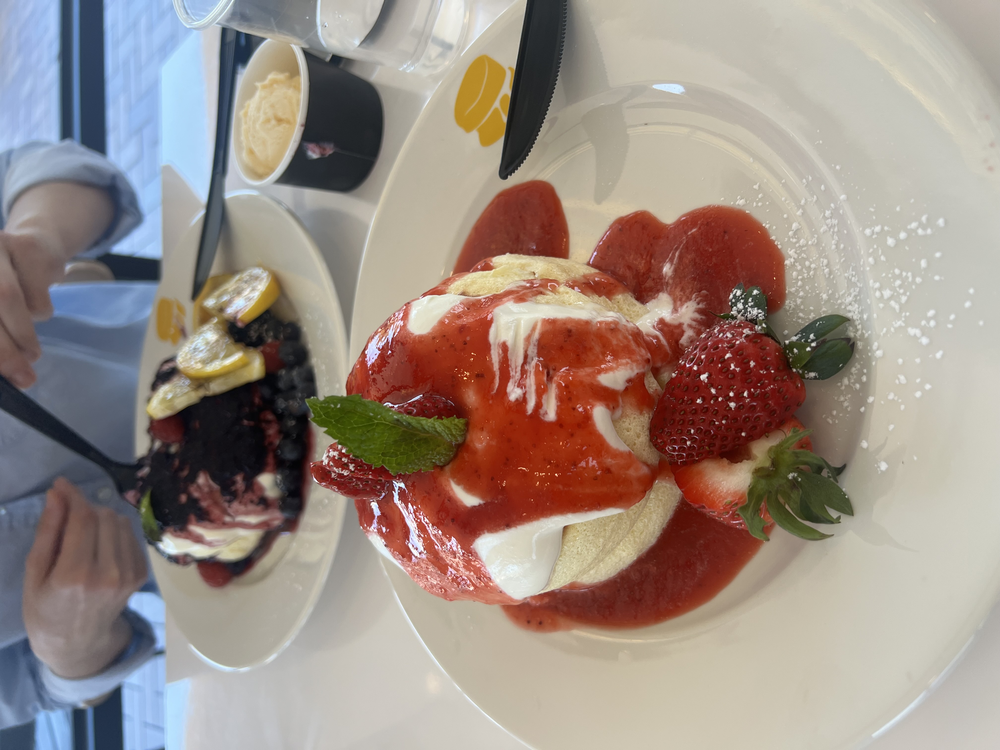

<PIL.MpoImagePlugin.MpoImageFile image mode=RGB size=4032x3024 at 0x7AF87CF03430> /content/drive/MyDrive/images/IMG_2692.jpg
Buffered data was truncated after reaching the output size limit.

In [ ]:
for img, path in get_image_paths(folder_path):
  print(img, path)


In [ ]:
root, ext = os.path.splitext(path)
print(root)
print(ext)

/content/drive/MyDrive/images/IMG_1927
.jpg


In [ ]:
model = genai.GenerativeModel("gemini-1.5-flash")

promt = """
Analyze the image in details.
Generate a descriptive image filename using:
-Relevant keywords describing the image, separated by underscores.
-Lowercases only.
-No special characters
-Keeo it short

Response ONLY with image filename(no extention)

Example:  A dinner table in backyard

"""

for image, path in get_image_paths(folder_path):
  response = model.generate_content([promt, image])
  root, ext = os.path.splitext(path)
  print(response.text.strip())
  print("********")
  print(response.text)

  new_filename = " " + response.text.strip() + ext
  directory = os.path.dirname(path)
  new_path = os.path.join(directory, new_filename)
  os.rename(path, new_path)

  print(f"{path} was renamed to {new_path}")

